In [1]:
from analysis.datasets import *
from analysis.first_analysis import plot_wind_parks_cumulative_capacity
from analysis.first_analysis import plot_installed_capacity_scatter
from analysis.first_analysis import plot_top_10_wind_parks_by_installed_capacity

## Analysis of 50Hertz Transmission Stammdaten file

In [2]:
aggregated_df = load_wind_turbine_coordinates_from_zips()

In [3]:
aggregated_df

,plz,installed_capacity_sum,eeg_count,longitude,latitude,cumulative_capacity,cumulative_percentage
350,17291,784115.0,316,13.869728,53.305662,784115.0,3.853595
269,14913,467460.0,232,13.087447,51.964120,1251575.0,6.150964
325,16928,309400.0,136,12.128915,53.136486,1560975.0,7.671535
495,39343,249880.0,137,11.275111,52.234049,1810855.0,8.899589
431,19357,238150.0,94,11.708186,53.171282,2049005.0,10.069996
...,...,...,...,...,...,...,...
34,2730,30.0,1,14.599376,51.007197,20347607.0,99.999916
528,98693,5.0,1,10.930109,50.687162,20347612.0,99.999941
81,4643,4.0,1,12.684230,51.037766,20347616.0,99.999961
203,8209,4.0,4,12.419988,50.488749,20347620.0,99.999980


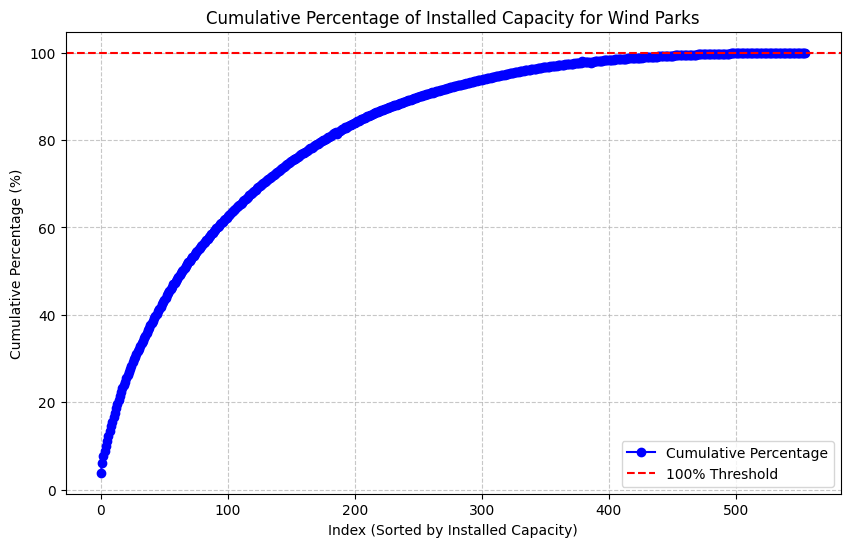

In [4]:
plot_wind_parks_cumulative_capacity(aggregated_df)

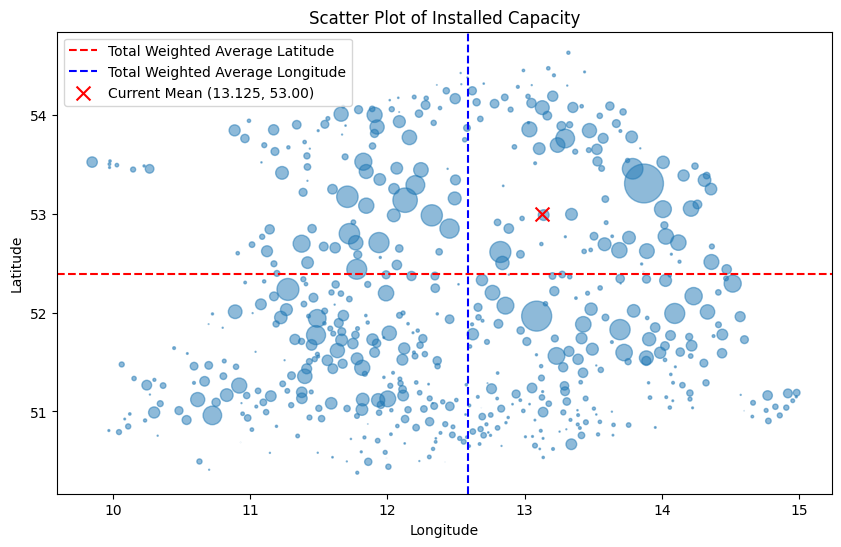

In [5]:
plot_installed_capacity_scatter(aggregated_df)

## 10 biggest wind parks from that file

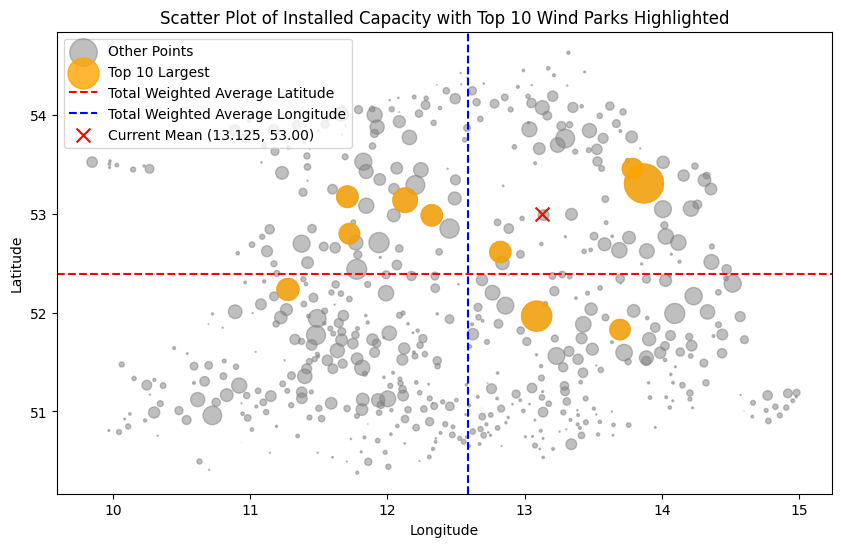

In [6]:
plot_top_10_wind_parks_by_installed_capacity(aggregated_df)

In [7]:
load_10_biggest_wind_turbines_by_installed_capacity(10)

,plz,installed_capacity_sum,eeg_count,longitude,latitude,cumulative_capacity,cumulative_percentage
350,17291,784115.0,316,13.869728,53.305662,784115.0,3.853595
269,14913,467460.0,232,13.087447,51.964120,1251575.0,6.150964
325,16928,309400.0,136,12.128915,53.136486,1560975.0,7.671535
495,39343,249880.0,137,11.275111,52.234049,1810855.0,8.899589
431,19357,238150.0,94,11.708186,53.171282,2049005.0,10.069996
323,16866,233800.0,124,12.323215,52.983119,2282805.0,11.219025
259,14641,229000.0,125,12.822919,52.612690,2511805.0,12.344463
357,17337,220250.0,96,13.786970,53.454327,2732055.0,13.426899
515,39606,216455.0,62,11.722935,52.797478,2948510.0,14.490685
299,15926,212600.0,104,13.694881,51.827624,3161110.0,15.535524


In [8]:
latitudes, longitudes = get_coordinates_of_geographic_mean_and_10_biggest_wind_turbines_by_installed_capacity()
longitudes

'12.5874825852499,13.8697277521,13.0874467805,12.1289151187,11.2751114319,11.7081863555,12.3232149188,12.822919471,13.7869695288,11.7229348021,13.6948811417'

In [18]:
weighted_longitude = (aggregated_df['longitude'] * aggregated_df['installed_capacity_sum']).sum() / aggregated_df['installed_capacity_sum'].sum()

weighted_latitude = (aggregated_df['latitude'] * aggregated_df['installed_capacity_sum']).sum() / aggregated_df['installed_capacity_sum'].sum()


# Adding the total weighted longitude to the front of the longitudes string to extract wind speed data at the mean from open-meteo
longitudes = str(weighted_longitude) + ','
longitudes += ','.join(top_10_biggest_wind_parks_50hertz['longitude'].astype(str))

latitudes = str(weighted_latitude) + ','
latitudes += ','.join(top_10_biggest_wind_parks_50hertz['latitude'].astype(str))

In [19]:
latitudes

'52.39094838412582,53.3056617956,51.964120382,53.1364856421,52.2340490976,53.1712818094,52.9831189693,52.6126903825,53.4543273912,52.7974781867,51.8276237744'

In [20]:
longitudes

'12.5874825852499,13.8697277521,13.0874467805,12.1289151187,11.2751114319,11.7081863555,12.3232149188,12.822919471,13.7869695288,11.7229348021,13.6948811417'

In [9]:
weighted_latitude, weighted_longitude

(52.39094838412582, 12.5874825852499)

## Get open-meteo wind speed data from the historical weather api (https://open-meteo.com/en/docs/historical-weather-api) for those 10 biggest locations
- include the coordinates at the weighted mean
- Total weighted mean latitude and longitude:
    - latitude: 52.40773
    - longitude: 12.523191

#### Download actual wind speed data at the locations of the top 10 biggest wind parks and its geographic mean from open meteo

In [11]:
download_top_10_biggest_wind_parks()

https://archive-api.open-meteo.com/v1/archive?latitude=52.39094838412582,53.3056617956,51.964120382,53.1364856421,52.2340490976,53.1712818094,52.9831189693,52.6126903825,53.4543273912,52.7974781867,51.8276237744&longitude=12.5874825852499,13.8697277521,13.0874467805,12.1289151187,11.2751114319,11.7081863555,12.3232149188,12.822919471,13.7869695288,11.7229348021,13.6948811417&start_date=2016-01-01&end_date=2024-12-31&hourly=wind_speed_10m,wind_speed_100m&wind_speed_unit=ms
Status Code: 200

Response Content: [{"latitude":52.40773,"longitude":12.523191,"generationtime_ms":9.617090225219727,"utc_offset_seconds":0,"timezone":"GMT","timezone_abbreviation":"GMT","elevation":30.0,"hourly_units":{"time":"iso8601","wind_speed_10m":"m/s","wind_speed_100m":"m/s"},"hourly":{"time":["2016-01-01T00:00","2016-01-01T01:00","2016-01-01T02:00","2016-01-01T03:00","2016-01-01T04:00","2016-01-01T05:00","2016-01-01T06:00","2016-01-01T07:00","2016-01-01T08:00","2016-01-01T09:00","2016-01-01T10:00","2016-01-0

#### Load

In [12]:
import pandas as pd
import json

def load_wind_park_data(file_path="../data/top_10_biggest_wind_parks/top_10_biggest_wind_parks_50hertz.json"):
    try:
        # Load the JSON file
        with open(file_path, "r") as f:
            data = json.load(f)
        
        # Initialize an empty list to hold the processed data
        processed_data = []

        # Iterate through each location's data in the list
        for location_data in data:
            # Extract 'hourly' data for each location
            hourly_data = location_data.get('hourly', {})
            
            # Check if 'time', 'wind_speed_10m', and 'wind_speed_100m' are in the hourly data
            if 'time' in hourly_data and 'wind_speed_10m' in hourly_data and 'wind_speed_100m' in hourly_data:
                # Create a DataFrame for this location's hourly data
                location_df = pd.DataFrame({
                    'time': hourly_data['time'],
                    'wind_speed_10m': hourly_data['wind_speed_10m'],
                    'wind_speed_100m': hourly_data['wind_speed_100m']
                })
                
                # Add metadata columns (latitude and longitude) from the location data
                location_df['latitude'] = location_data['latitude']
                location_df['longitude'] = location_data['longitude']
                
                # Append the location's data to the processed_data list
                processed_data.append(location_df)

        # Concatenate all individual DataFrames from each location
        df = pd.concat(processed_data, ignore_index=True)

        # Add transformation: pivot the data to reshape it
        df['location'] = df['latitude'].astype(str) + "_" + df['longitude'].astype(str)  # Unique location identifier
        pivoted_df = df.pivot(index='time', columns='location', values=['wind_speed_10m', 'wind_speed_100m'])
        pivoted_df.columns = [f"{col[0]}_{col[1]}" for col in pivoted_df.columns]  # Flatten multi-level columns
        pivoted_df.index.name = "time"  # Optional: explicitly name the index
        pivoted_df.index = pd.to_datetime(pivoted_df.index, errors='coerce')
        # Rename the specific columns
        pivoted_df = pivoted_df.rename(columns={
            "wind_speed_10m_52.40773_12.523191": "wind_speed_10m_mean",
            "wind_speed_100m_52.40773_12.523191": "wind_speed_100m_mean"
        })

        print(f"Data loaded and transformed successfully. Shape of DataFrame: {pivoted_df.shape}")
        return pivoted_df

    except FileNotFoundError:
        print(f"File not found: {file_path}")
    except json.JSONDecodeError:
        print(f"Error decoding the JSON file: {file_path}")
    except KeyError:
        print("The expected data structure is not found in the JSON file.")
    except Exception as e:
        print(f"An error occurred: {e}")


#### show

In [13]:
top_10_ws_open_meteo = load_wind_park_data()
top_10_ws_open_meteo

Data loaded and transformed successfully. Shape of DataFrame: (78192, 22)


,wind_speed_10m_51.84534_13.656307,wind_speed_10m_51.98594_13.045872,wind_speed_10m_52.26713_11.312384,wind_speed_10m_mean,wind_speed_10m_52.618626_12.761193,wind_speed_10m_52.829525_11.6510315,wind_speed_10m_52.97012_12.372882,wind_speed_10m_53.110718_12.079395,wind_speed_10m_53.18102_11.761364,wind_speed_10m_53.321613_13.859315,...,wind_speed_100m_51.98594_13.045872,wind_speed_100m_52.26713_11.312384,wind_speed_100m_mean,wind_speed_100m_52.618626_12.761193,wind_speed_100m_52.829525_11.6510315,wind_speed_100m_52.97012_12.372882,wind_speed_100m_53.110718_12.079395,wind_speed_100m_53.18102_11.761364,wind_speed_100m_53.321613_13.859315,wind_speed_100m_53.46221_13.7404585
time,,,,,,,,,,,,,,,,,,,,,
2016-01-01 00:00:00,2.48,2.41,2.48,1.94,1.86,1.84,1.80,1.97,1.80,1.90,...,5.16,5.71,4.52,4.33,5.02,4.47,4.86,5.00,3.72,4.27
2016-01-01 01:00:00,2.77,2.55,2.62,2.00,2.00,2.05,1.78,1.94,1.72,2.02,...,5.50,5.97,4.69,4.47,5.24,4.48,4.72,4.83,3.86,4.38
2016-01-01 02:00:00,2.75,2.62,2.64,2.12,2.12,2.06,1.91,2.06,1.84,1.90,...,5.49,5.87,4.97,4.80,5.32,4.65,4.84,4.94,3.98,4.33
2016-01-01 03:00:00,2.91,2.66,2.56,2.13,2.28,1.92,1.98,2.26,1.84,2.01,...,5.77,5.61,5.06,5.15,5.06,4.98,5.23,4.97,4.31,4.55
2016-01-01 04:00:00,2.97,2.47,2.41,1.91,2.00,1.70,1.70,1.84,1.66,2.26,...,5.41,5.41,4.62,4.78,4.70,4.46,4.79,4.50,4.72,4.84
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-12-01 19:00:00,3.09,4.41,2.71,3.61,3.99,2.83,3.40,3.85,3.69,3.75,...,9.13,6.14,7.52,8.11,6.40,7.53,8.21,7.64,7.86,9.00
2024-12-01 20:00:00,3.37,4.88,2.40,3.49,3.89,2.73,3.10,3.63,3.57,3.82,...,9.64,5.24,7.52,8.12,6.15,7.20,7.81,7.38,7.85,9.18
2024-12-01 21:00:00,3.37,4.86,2.55,3.55,3.68,2.59,3.32,3.46,3.36,3.75,...,9.47,4.75,7.65,7.77,5.96,7.40,7.56,7.00,7.82,9.10


interpolate 1h intervals to 15-minute intervals

In [14]:
top_10_15min = top_10_ws_open_meteo.resample("15min").interpolate(method="linear")
top_10_15min

,wind_speed_10m_51.84534_13.656307,wind_speed_10m_51.98594_13.045872,wind_speed_10m_52.26713_11.312384,wind_speed_10m_mean,wind_speed_10m_52.618626_12.761193,wind_speed_10m_52.829525_11.6510315,wind_speed_10m_52.97012_12.372882,wind_speed_10m_53.110718_12.079395,wind_speed_10m_53.18102_11.761364,wind_speed_10m_53.321613_13.859315,...,wind_speed_100m_51.98594_13.045872,wind_speed_100m_52.26713_11.312384,wind_speed_100m_mean,wind_speed_100m_52.618626_12.761193,wind_speed_100m_52.829525_11.6510315,wind_speed_100m_52.97012_12.372882,wind_speed_100m_53.110718_12.079395,wind_speed_100m_53.18102_11.761364,wind_speed_100m_53.321613_13.859315,wind_speed_100m_53.46221_13.7404585
time,,,,,,,,,,,,,,,,,,,,,
2016-01-01 00:00:00,2.4800,2.4100,2.4800,1.9400,1.8600,1.8400,1.800,1.9700,1.80,1.9000,...,5.1600,5.710,4.5200,4.330,5.0200,4.4700,4.8600,5.0000,3.7200,4.2700
2016-01-01 00:15:00,2.5525,2.4450,2.5150,1.9550,1.8950,1.8925,1.795,1.9625,1.78,1.9300,...,5.2450,5.775,4.5625,4.365,5.0750,4.4725,4.8250,4.9575,3.7550,4.2975
2016-01-01 00:30:00,2.6250,2.4800,2.5500,1.9700,1.9300,1.9450,1.790,1.9550,1.76,1.9600,...,5.3300,5.840,4.6050,4.400,5.1300,4.4750,4.7900,4.9150,3.7900,4.3250
2016-01-01 00:45:00,2.6975,2.5150,2.5850,1.9850,1.9650,1.9975,1.785,1.9475,1.74,1.9900,...,5.4150,5.905,4.6475,4.435,5.1850,4.4775,4.7550,4.8725,3.8250,4.3525
2016-01-01 01:00:00,2.7700,2.5500,2.6200,2.0000,2.0000,2.0500,1.780,1.9400,1.72,2.0200,...,5.5000,5.970,4.6900,4.470,5.2400,4.4800,4.7200,4.8300,3.8600,4.3800
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-12-01 22:00:00,3.5300,4.8000,2.3500,3.4100,3.7100,2.2200,3.270,3.3300,3.23,3.7600,...,9.3000,4.540,7.5400,7.760,5.5300,7.2100,7.3000,6.7500,7.8900,9.2300
2024-12-01 22:15:00,3.5425,4.8075,2.2125,3.3875,3.7075,2.2025,3.240,3.2975,3.26,3.7975,...,9.3225,4.335,7.4850,7.765,5.4725,7.1450,7.2175,6.8000,7.9225,9.2525
2024-12-01 22:30:00,3.5550,4.8150,2.0750,3.3650,3.7050,2.1850,3.210,3.2650,3.29,3.8350,...,9.3450,4.130,7.4300,7.770,5.4150,7.0800,7.1350,6.8500,7.9550,9.2750


In [15]:
top_10_15min_transf = minute_to_daily_50Hertz(top_10_15min)

In [16]:
selected_columns = [col for col in top_10_15min_transf.columns if col.endswith("09_00")]

# Create a new DataFrame with the selected columns
filtered_df = top_10_15min_transf[selected_columns]
filtered_df

,wind_speed_10m_51.84534_13.656307_09_00,wind_speed_10m_51.98594_13.045872_09_00,wind_speed_10m_52.26713_11.312384_09_00,wind_speed_10m_mean_09_00,wind_speed_10m_52.618626_12.761193_09_00,wind_speed_10m_52.829525_11.6510315_09_00,wind_speed_10m_52.97012_12.372882_09_00,wind_speed_10m_53.110718_12.079395_09_00,wind_speed_10m_53.18102_11.761364_09_00,wind_speed_10m_53.321613_13.859315_09_00,...,wind_speed_100m_51.98594_13.045872_09_00,wind_speed_100m_52.26713_11.312384_09_00,wind_speed_100m_mean_09_00,wind_speed_100m_52.618626_12.761193_09_00,wind_speed_100m_52.829525_11.6510315_09_00,wind_speed_100m_52.97012_12.372882_09_00,wind_speed_100m_53.110718_12.079395_09_00,wind_speed_100m_53.18102_11.761364_09_00,wind_speed_100m_53.321613_13.859315_09_00,wind_speed_100m_53.46221_13.7404585_09_00
date,,,,,,,,,,,,,,,,,,,,,
2016-01-01,3.14,2.92,2.42,2.50,2.56,2.33,2.25,2.52,2.19,2.53,...,5.29,4.92,5.06,5.09,5.10,5.09,5.44,5.10,4.73,4.49
2016-01-02,5.20,4.80,5.83,5.14,5.33,5.18,5.36,5.81,5.32,6.17,...,7.22,8.82,7.91,8.19,8.00,8.47,9.05,8.49,9.11,8.93
2016-01-03,5.45,5.46,5.82,5.65,5.85,5.92,6.10,6.65,6.17,6.50,...,8.26,8.77,8.71,8.93,9.04,9.46,9.99,9.60,9.58,9.35
2016-01-04,4.41,4.51,4.28,4.90,5.10,5.01,5.51,6.05,5.62,5.97,...,7.20,6.60,7.83,8.04,7.85,8.66,9.34,8.80,8.96,8.62
2016-01-05,4.06,4.04,4.26,4.50,4.51,4.60,4.60,4.82,4.71,4.20,...,6.03,6.41,6.70,6.70,6.92,6.92,7.14,7.13,6.00,5.64
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-11-27,2.69,2.49,2.67,1.70,3.09,3.41,3.31,3.65,3.50,4.12,...,5.84,4.43,4.19,4.32,4.88,4.72,5.09,5.19,5.77,6.23
2024-11-28,8.59,7.83,10.07,8.11,7.95,8.30,6.39,6.59,6.91,3.35,...,12.69,15.05,13.82,12.57,14.10,10.62,11.62,11.20,5.75,6.21
2024-11-29,3.08,3.11,0.97,1.92,2.15,0.80,2.70,0.94,0.91,3.09,...,4.50,1.55,2.60,3.91,1.07,3.96,1.25,1.70,4.52,4.33


In [17]:
from analysis.datasets import *

In [18]:
aggregated_power = load_entsoe()
aggregated_power

Loaded file ..\data\entsoe\Actual Generation per Production Type_201601010000-201701010000.csv with columns: ['Area', 'MTU', 'Wind Offshore  - Actual Aggregated [MW]', 'Wind Onshore  - Actual Aggregated [MW]']
Loaded file ..\data\entsoe\Actual Generation per Production Type_201701010000-201801010000.csv with columns: ['Area', 'MTU', 'Wind Offshore  - Actual Aggregated [MW]', 'Wind Onshore  - Actual Aggregated [MW]']
Loaded file ..\data\entsoe\Actual Generation per Production Type_201801010000-201901010000.csv with columns: ['Area', 'MTU', 'Wind Offshore  - Actual Aggregated [MW]', 'Wind Onshore  - Actual Aggregated [MW]']
Loaded file ..\data\entsoe\Actual Generation per Production Type_201901010000-202001010000.csv with columns: ['Area', 'MTU', 'Wind Offshore  - Actual Aggregated [MW]', 'Wind Onshore  - Actual Aggregated [MW]']
Loaded file ..\data\entsoe\Actual Generation per Production Type_202001010000-202101010000.csv with columns: ['Area', 'MTU', 'Wind Offshore  - Actual Aggregated

KeyError: "['Area'] not found in axis"

In [43]:
reshaped = minute_to_daily_50Hertz(aggregated_power)
selected_columns = [col for col in reshaped.columns if col.endswith("onshore_09_00")]

# Create a new DataFrame with the selected columns
filtered_df2 = reshaped[selected_columns]
filtered_df2

,onshore_09_00
date,
2016-01-01,1080.0
2016-01-02,4600.0
2016-01-03,5673.0
2016-01-04,3262.0
2016-01-05,1863.0
...,...
2024-12-27,NaN
2024-12-28,NaN
2024-12-29,NaN


In [45]:
result = pd.merge(filtered_df, filtered_df2, on='date', how='outer')
result

,wind_speed_10m_51.84534_13.656307_09_00,wind_speed_10m_51.98594_13.045872_09_00,wind_speed_10m_52.26713_11.312384_09_00,wind_speed_10m_mean_09_00,wind_speed_10m_52.618626_12.761193_09_00,wind_speed_10m_52.829525_11.6510315_09_00,wind_speed_10m_52.97012_12.372882_09_00,wind_speed_10m_53.110718_12.079395_09_00,wind_speed_10m_53.18102_11.761364_09_00,wind_speed_10m_53.321613_13.859315_09_00,...,wind_speed_100m_52.26713_11.312384_09_00,wind_speed_100m_mean_09_00,wind_speed_100m_52.618626_12.761193_09_00,wind_speed_100m_52.829525_11.6510315_09_00,wind_speed_100m_52.97012_12.372882_09_00,wind_speed_100m_53.110718_12.079395_09_00,wind_speed_100m_53.18102_11.761364_09_00,wind_speed_100m_53.321613_13.859315_09_00,wind_speed_100m_53.46221_13.7404585_09_00,onshore_09_00
date,,,,,,,,,,,,,,,,,,,,,
2016-01-01,3.14,2.92,2.42,2.50,2.56,2.33,2.25,2.52,2.19,2.53,...,4.92,5.06,5.09,5.10,5.09,5.44,5.10,4.73,4.49,1080.0
2016-01-02,5.20,4.80,5.83,5.14,5.33,5.18,5.36,5.81,5.32,6.17,...,8.82,7.91,8.19,8.00,8.47,9.05,8.49,9.11,8.93,4600.0
2016-01-03,5.45,5.46,5.82,5.65,5.85,5.92,6.10,6.65,6.17,6.50,...,8.77,8.71,8.93,9.04,9.46,9.99,9.60,9.58,9.35,5673.0
2016-01-04,4.41,4.51,4.28,4.90,5.10,5.01,5.51,6.05,5.62,5.97,...,6.60,7.83,8.04,7.85,8.66,9.34,8.80,8.96,8.62,3262.0
2016-01-05,4.06,4.04,4.26,4.50,4.51,4.60,4.60,4.82,4.71,4.20,...,6.41,6.70,6.70,6.92,6.92,7.14,7.13,6.00,5.64,1863.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-12-27,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-12-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-12-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


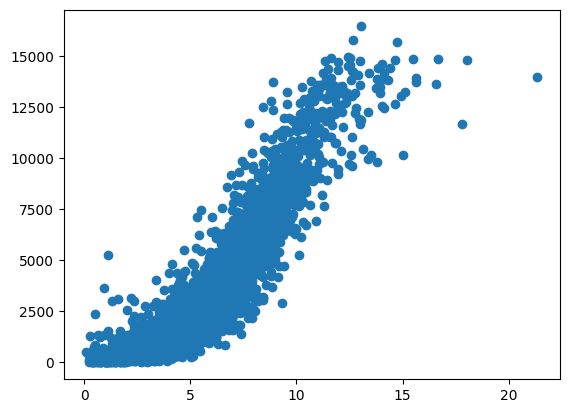

In [48]:
plt.scatter(result['wind_speed_100m_mean_09_00'], result['onshore_09_00'])

In [15]:
# Extracting the columns for 10m wind speed for each location (wind speed at 10m columns)
wind_speed_10m_cols = [col for col in top_10_ws_open_meteo.columns if "wind_speed_10m" in col]

# Prepare the plot
plt.figure(figsize=(12, 8))

# Loop over each wind speed column
for col in wind_speed_10m_cols:
    # Extract the location from the column name (after the third dash)
    location = "_".join(col.split('_')[3:])  # Getting latitude and longitude from the column name
    
    # Plot the wind speed for this location
    plt.plot(top_10_ws_open_meteo.index, top_10_ws_open_meteo[col], label=location, linewidth=0.6)

# Add title and labels
plt.title('Wind Speed at 10m for Each Location Over Time')
plt.xlabel('Time')
plt.ylabel('Wind Speed (m/s)')
# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Show the legend to distinguish between different locations
plt.legend(title="Location (Lat_Lon)", loc='upper right', bbox_to_anchor=(1.1, 1))

# Display the plot
plt.tight_layout()
plt.show()

KeyboardInterrupt: 

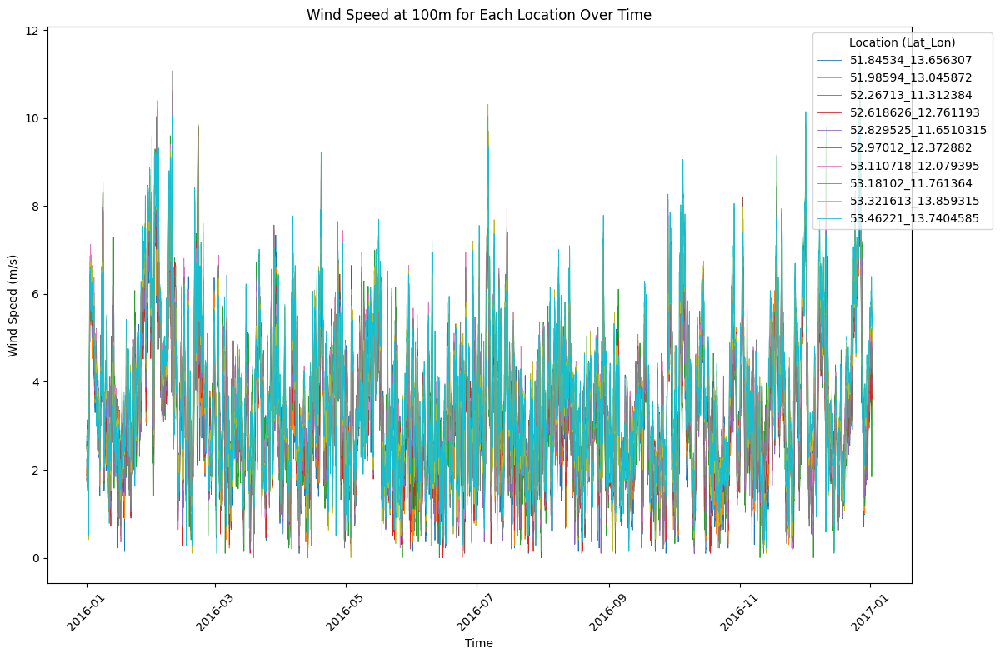

In [59]:
# Extracting the columns for 10m wind speed for each location (wind speed at 10m columns)
wind_speed_100m_cols = [col for col in top_10_ws_open_meteo.columns if "wind_speed_100m" in col]

# Prepare the plot
plt.figure(figsize=(12, 8))

# Loop over each wind speed column
for col in wind_speed_10m_cols:
    # Extract the location from the column name (after the third dash)
    location = "_".join(col.split('_')[3:])  # Getting latitude and longitude from the column name
    
    # Plot the wind speed for this location
    plt.plot(top_10_ws_open_meteo.index, top_10_ws_open_meteo[col], label=location, linewidth=0.6)

# Add title and labels
plt.title('Wind Speed at 100m for Each Location Over Time')
plt.xlabel('Time')
plt.ylabel('Wind Speed (m/s)')

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Show the legend to distinguish between different locations
plt.legend(title="Location (Lat_Lon)", loc='upper right', bbox_to_anchor=(1.1, 1))

# Display the plot
plt.tight_layout()
plt.show()

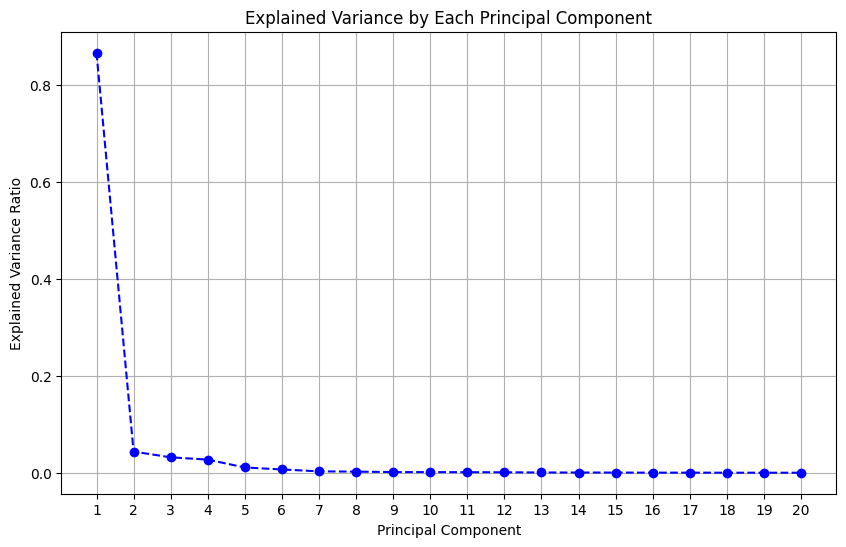

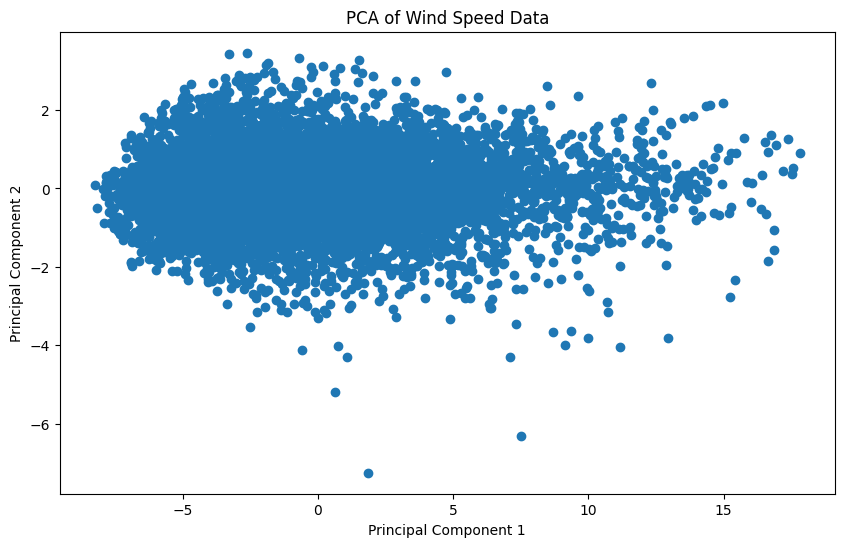

Data loaded, transformed, and PCA applied successfully. Shape of DataFrame: (8808, 20)
Explained Variance Ratio: [8.67367001e-01 4.37508767e-02 3.18775893e-02 2.71217885e-02
 1.08824698e-02 6.82015765e-03 2.90822943e-03 2.32016182e-03
 1.40202918e-03 1.30323333e-03 1.14445065e-03 9.85716263e-04
 5.30590195e-04 4.92837418e-04 3.86144436e-04 2.23732706e-04
 1.91081830e-04 1.24210196e-04 9.60816234e-05 7.16176662e-05]


In [41]:
 # Drop 'time' index and use only the numeric wind speed columns for PCA
pca_data = top_10_ws_open_meteo.select_dtypes(include=['float64', 'int64'])

# Standardize the data (important for PCA)
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
from sklearn.decomposition import PCA
pca_data_scaled = scaler.fit_transform(pca_data)

# Perform PCA
pca = PCA()
pca_result = pca.fit_transform(pca_data_scaled)

# Create a DataFrame for the PCA results
pca_df = pd.DataFrame(pca_result, columns=[f"Principal Component {i+1}" for i in range(pca_result.shape[1])], index=top_10_ws_open_meteo.index)

# --- Plot the Explained Variance Ratio (Scree Plot) ---
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(pca.explained_variance_ratio_) + 1), pca.explained_variance_ratio_, marker='o', linestyle='--', color='b')
plt.title('Explained Variance by Each Principal Component')
plt.xlabel('Principal Component')
plt.ylabel('Explained Variance Ratio')
plt.xticks(range(1, len(pca.explained_variance_ratio_) + 1))
plt.grid(True)
plt.show()

# --- Plot the PCA Results ---
plt.figure(figsize=(10, 6))
plt.scatter(pca_df['Principal Component 1'], pca_df['Principal Component 2'])
plt.title("PCA of Wind Speed Data")
plt.xlabel("Principal Component 1")
plt.ylabel("Principal Component 2")
plt.show()

print(f"Data loaded, transformed, and PCA applied successfully. Shape of DataFrame: {pca_data.shape}")
print(f"Explained Variance Ratio: {pca.explained_variance_ratio_}")

## Compare latitude, longitude coordinates returned by open-meteo for the 10 biggest locations with their original coordinates in the Stammdaten file

In [14]:
unique_locations = top_10_ws_open_meteo.drop_duplicates(subset=['latitude', 'longitude'])
unique_locations


,time,wind_speed_10m,wind_speed_100m,latitude,longitude
0,2016-01-01T00:00,1.90,3.72,53.321613,13.859315
24,2016-01-01T00:00,2.41,5.16,51.985940,13.045872
48,2016-01-01T00:00,1.97,4.86,53.110718,12.079395
72,2016-01-01T00:00,2.48,5.71,52.267130,11.312384
96,2016-01-01T00:00,1.80,5.00,53.181020,11.761364
120,2016-01-01T00:00,1.80,4.47,52.970120,12.372882
144,2016-01-01T00:00,1.86,4.33,52.618626,12.761193
168,2016-01-01T00:00,2.20,4.27,53.462210,13.740459
192,2016-01-01T00:00,1.84,5.02,52.829525,11.651032
216,2016-01-01T00:00,2.48,5.05,51.845340,13.656307


In [15]:
top_10_biggest_wind_parks_50hertz

,index,plz,installed_capacity_sum,eeg_count,longitude,latitude,cumulative_capacity,cumulative_percentage
0,350,17291,784115.0,316,13.869728,53.305662,784115.0,3.853595
1,269,14913,467460.0,232,13.087447,51.964120,1251575.0,6.150964
2,325,16928,309400.0,136,12.128915,53.136486,1560975.0,7.671535
3,495,39343,249880.0,137,11.275111,52.234049,1810855.0,8.899589
4,431,19357,238150.0,94,11.708186,53.171282,2049005.0,10.069996
5,323,16866,233800.0,124,12.323215,52.983119,2282805.0,11.219025
6,259,14641,229000.0,125,12.822919,52.612690,2511805.0,12.344463
7,357,17337,220250.0,96,13.786970,53.454327,2732055.0,13.426899
8,515,39606,216455.0,62,11.722935,52.797478,2948510.0,14.490685
9,299,15926,212600.0,104,13.694881,51.827624,3161110.0,15.535524
